## Create Networks

From the dictionaries created in the previous notebook, create adjacency networks for each goal, these can then be summed to create adjacency networks for each team.

In [1]:
import json
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
import matplotlib.image as mpimg


In [2]:
def createGoalGraphs(goals):
    """
        create graph for each individual goal
    """
    goals_matrices = {}
    for team, goal in goals.items():
        goals_matrices[team] = []
        for g in goal:
            temp_dict = {}
            region_list = []
            player_list = []
            
            region_list.append(g['region'])
            player_list.append(g['playerIndex'])
            
            for p in g['passes']:
                region_list.append(p['region'])
                player_list.append(p['playerIndex'])
                
            edge_list_regions = []
            goal_matrix_regions = np.zeros((18,18))
            
            edge_list_players = []
            goal_matrix_players = np.zeros((11,11))
            
            for i in range(len(region_list)-1):
                edge_list_regions.append([region_list[i+1], region_list[i]])
                goal_matrix_regions[region_list[i+1]-1][region_list[i]-1] += 1
    
                if player_list[i+1] == player_list[i]:
                    continue
                else:
                    edge_list_players.append([player_list[i+1], player_list[i]])
                    goal_matrix_players[player_list[i+1]-1][player_list[i]-1] += 1
                
            temp_dict['opponentId'] = g['opponentId']
            temp_dict['matchId'] = g['matchId']
            temp_dict['regionEdgeList'] = edge_list_regions
            temp_dict['playerEdgeList'] = edge_list_players
            temp_dict['regionMatrix'] = goal_matrix_regions
            temp_dict['playerMatrix'] = goal_matrix_players
            goals_matrices[team].append(temp_dict)
    return goals_matrices



In [3]:
def createTotalGraphs(goals_matrices):
    """
        Sum goal graphs to create total graphs
    """
    total_goals_matrices = {}
    for team, goal in goals_matrices.items():
        total_region_matrix = np.zeros((18,18))
        total_player_matrix = np.zeros((11,11))
        
        temp_dict = {}
        for g in goal:
            total_region_matrix += g['regionMatrix']
            total_player_matrix += g['playerMatrix']
            
        temp_dict['total_region_matrix'] = total_region_matrix
        temp_dict['total_player_matrix'] = total_player_matrix
        total_goals_matrices[team] = temp_dict
    return total_goals_matrices


In [ ]:
class NumpyEncoder(json.JSONEncoder):
    """
        Class to write numpy array as list in JSON object
    """
    def default(self, obj):
        if isinstance(obj, np.ndarray):
            return obj.tolist()
        return json.JSONEncoder.default(self, obj)

For each league, create the goals matrix and total matrix and output to a file

In [5]:
with open('../Data/output/goals/goals_England.json') as f:
    goalsEngland = json.load(f)

goals_matrices_england = createGoalGraphs(goalsEngland)
total_goals_matrices_england = createTotalGraphs(goals_matrices_england)

# with open('../Data/goals_matrices_England.json', 'w') as f:
#     json.dump(total_goals_matrices_england, f, cls=NumpyEncoder)


In [47]:
with open('../Data/output/goals_Spain.json') as f:
    goalsSpain = json.load(f)

goals_matrices_spain = createGoalGraphs(goalsSpain)
total_goals_matrices_spain = createTotalGraphs(goals_matrices_spain)

with open('../Data/goals_matrices_spain.json', 'w') as f:
    json.dump(total_goals_matrices_spain, f, cls=NumpyEncoder)


In [48]:
with open('../Data/output/goals_Italy.json') as f:
    goalsItaly = json.load(f)

goals_matrices_italy = createGoalGraphs(goalsItaly)
total_goals_matrices_italy = createTotalGraphs(goals_matrices_italy)

with open('../Data/goals_matrices_italy.json', 'w') as f:
    json.dump(total_goals_matrices_italy, f, cls=NumpyEncoder)


In [49]:
with open('../Data/output/goals_France.json') as f:
    goalsFrance = json.load(f)

goals_matrices_france = createGoalGraphs(goalsFrance)
total_goals_matrices_france = createTotalGraphs(goals_matrices_france)

with open('../Data/goals_matrices_france.json', 'w') as f:
    json.dump(total_goals_matrices_france, f, cls=NumpyEncoder)


In [50]:
with open('../Data/output/goals_Germany.json') as f:
    goalsGermany = json.load(f)

goals_matrices_germany = createGoalGraphs(goalsGermany)
total_goals_matrices_germany = createTotalGraphs(goals_matrices_germany)

with open('../Data/goals_matrices_Germany.json', 'w') as f:
    json.dump(total_goals_matrices_germany, f, cls=NumpyEncoder)


### Visualisation of Networks

Output visualisation of networks, this is mainly for validation and to show examples in report

In [8]:
# Define size of image
extent = [0, 405, 0, 240]


(0.0, 405.0, 0.0, 240.0)

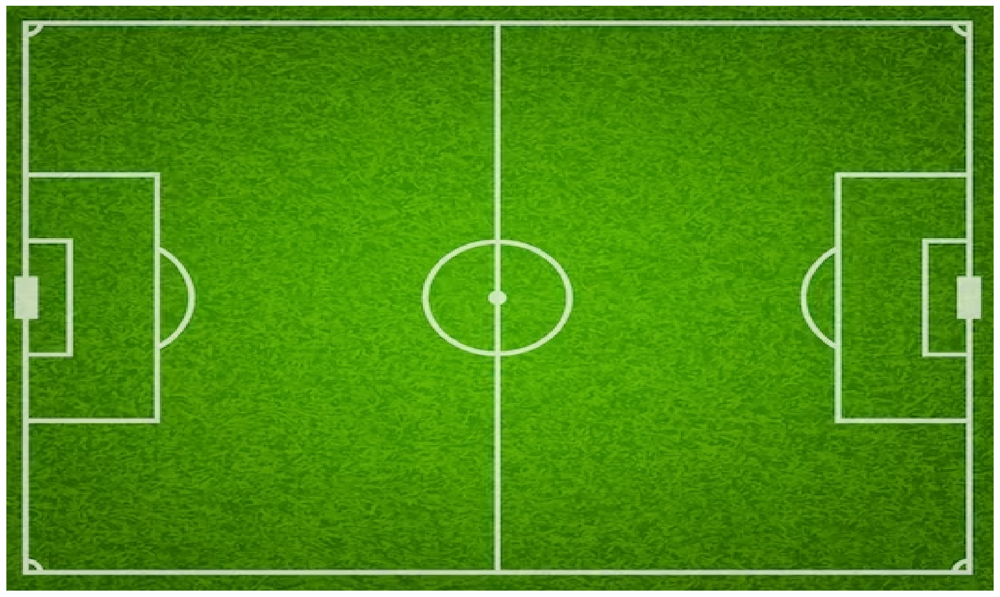

In [10]:
# read in pitch image
img = mpimg.imread('../images/pitch3.png')

# define coords for regions
x = [34, 34, 34, 102, 102, 102, 169, 169, 169, 237, 237, 237, 305, 305, 305, 372, 372, 372]
y = [200, 120, 40, 200, 120, 40, 200, 120, 40, 200, 120, 40, 200, 120, 40, 200, 120, 40]
coords = {}
for i in range(18):
    coords[i] = zip([x[i], y[i]])

fig = plt.figure(frameon=False, figsize=(20,40))
    
plt.imshow(img, extent=extent, interpolation='nearest')

plt.axis('off')

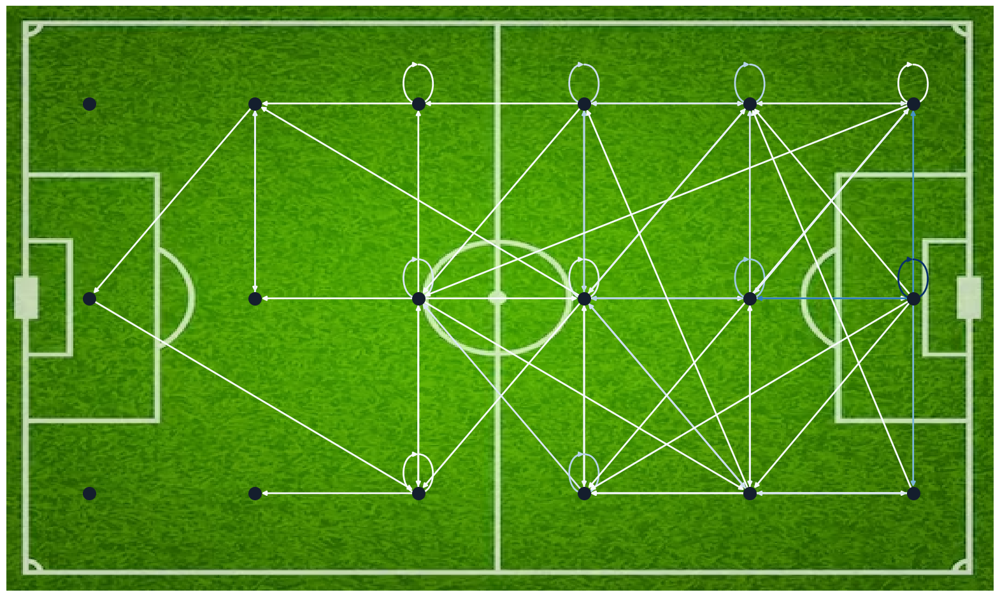

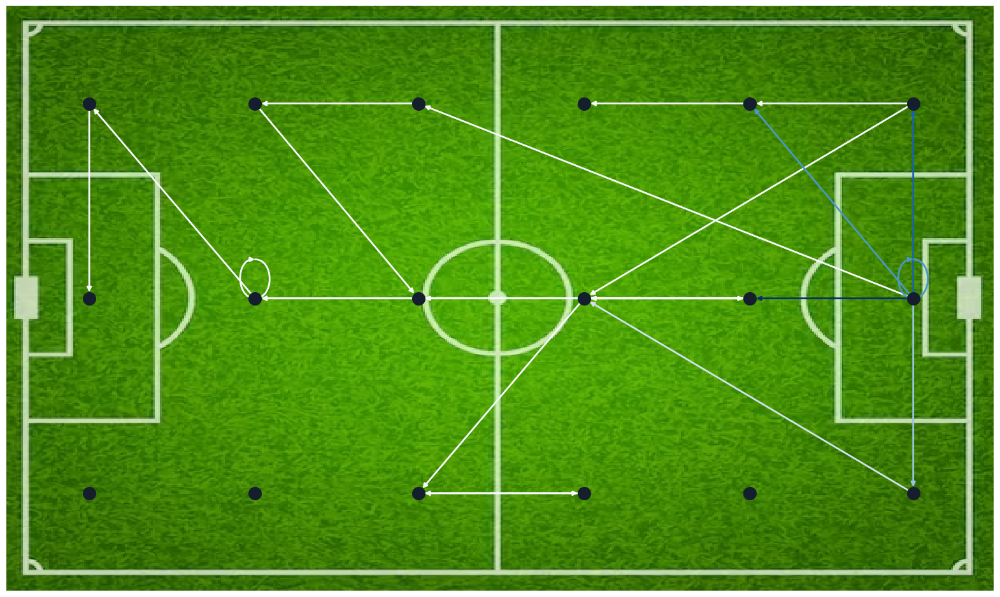

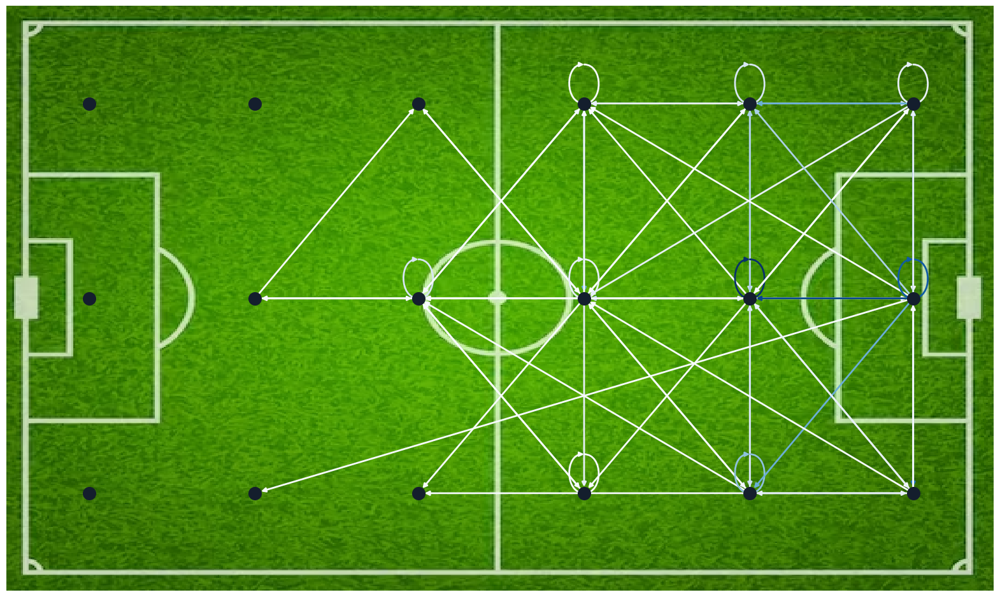

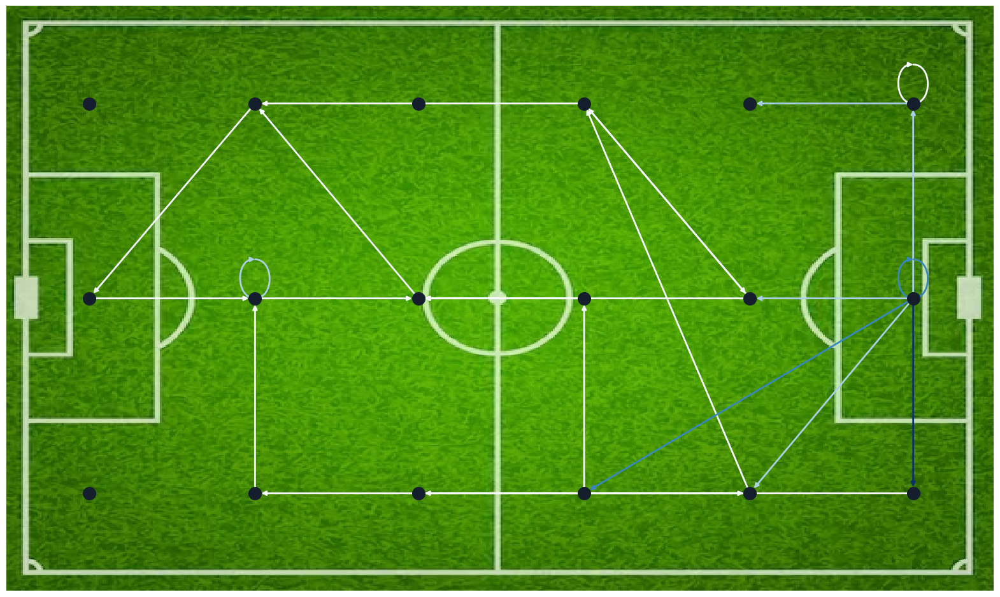

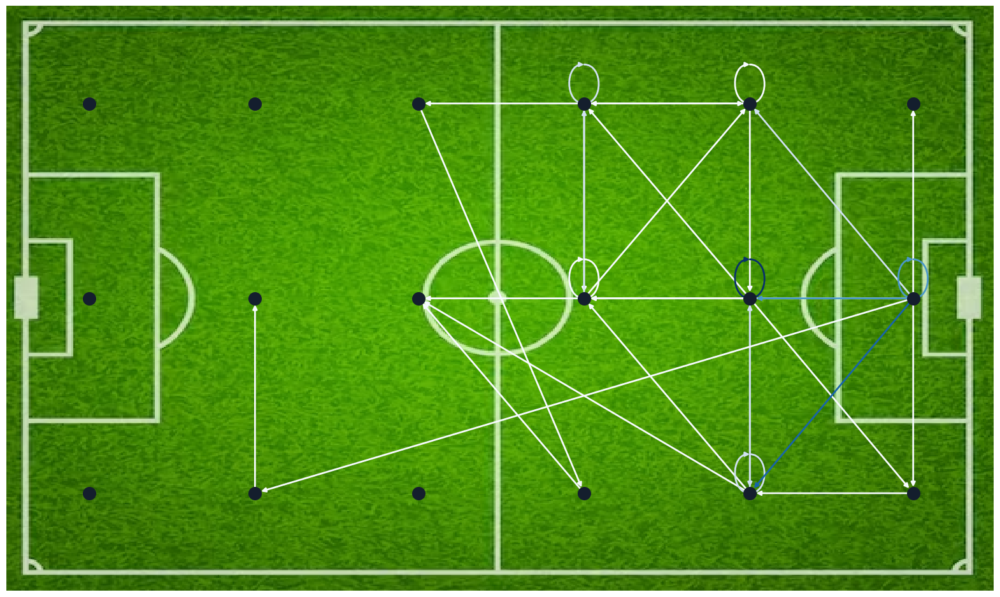

...

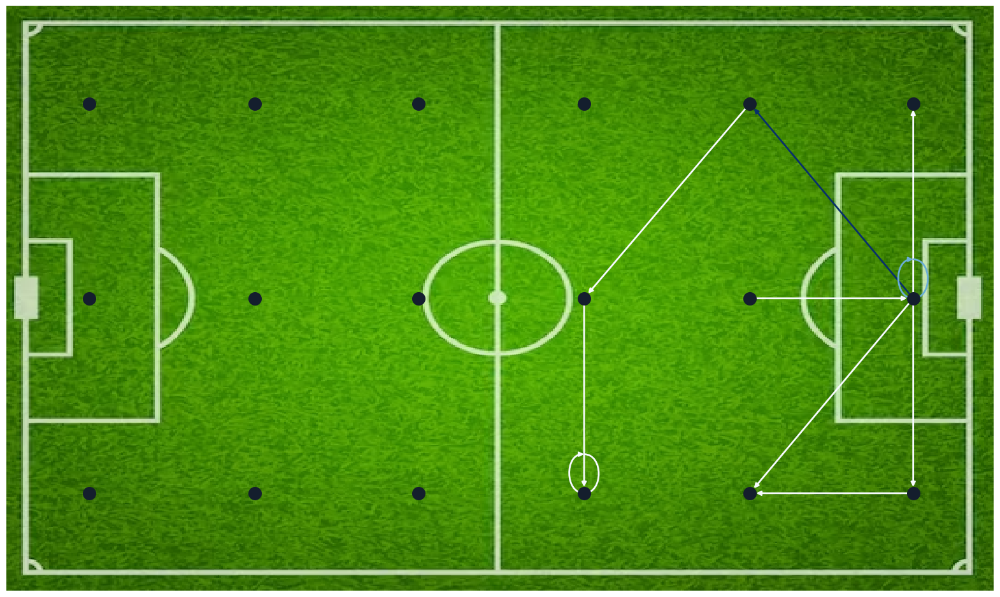

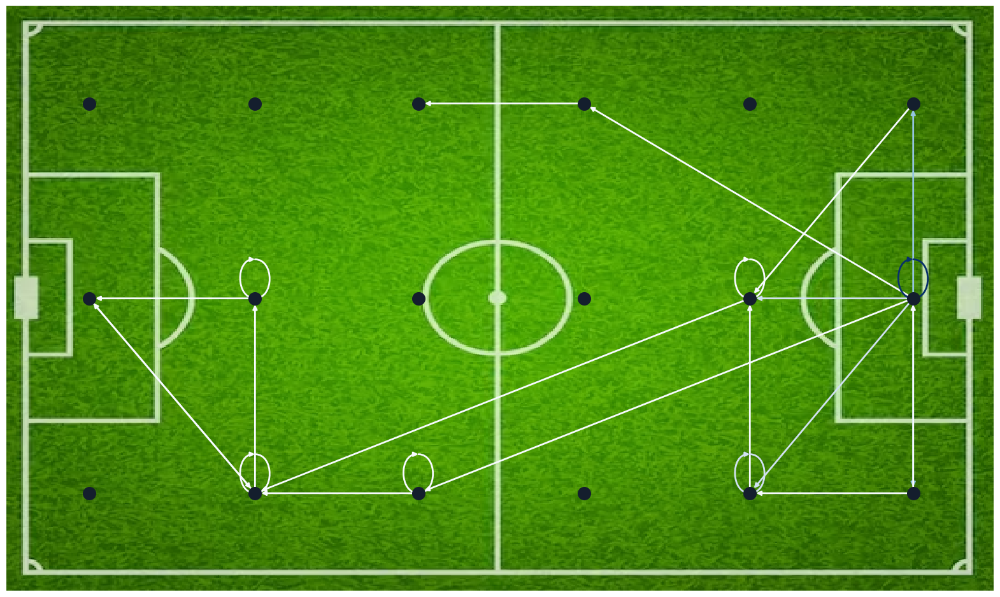

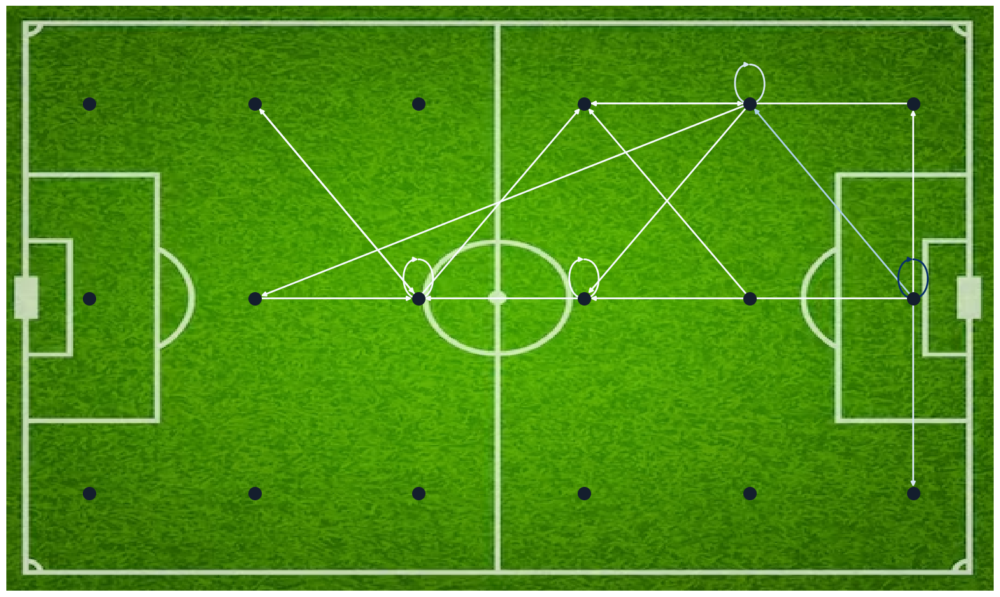

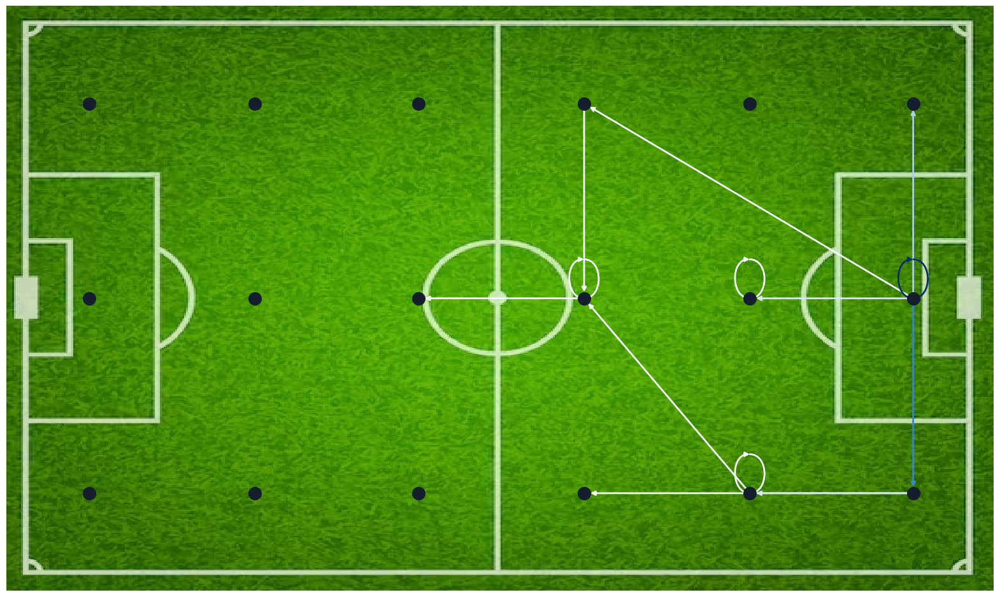

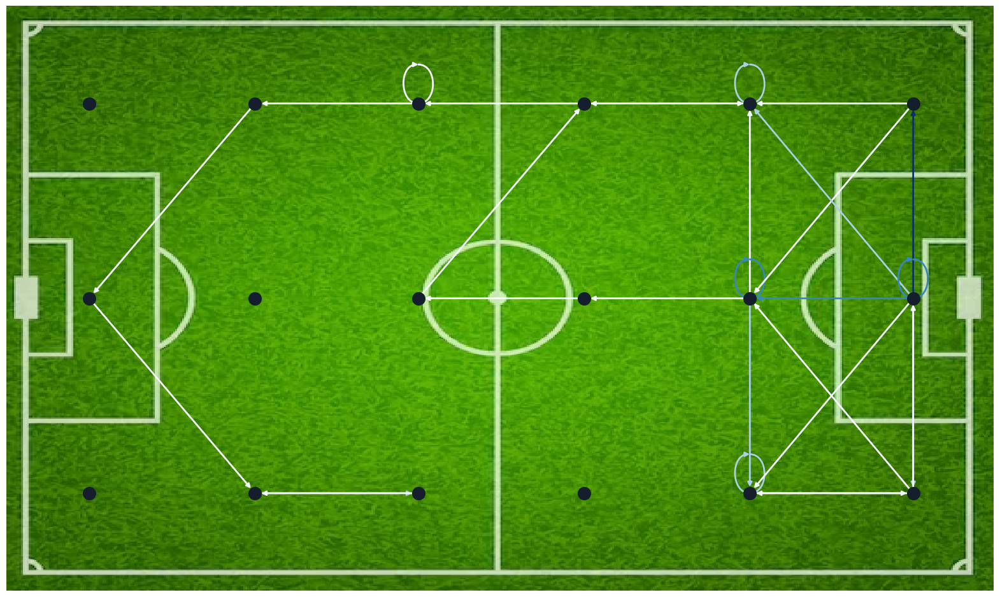

In [64]:
# Output regions network for each team

img = mpimg.imread('../images/pitch3.png')

x = [34, 34, 34, 102, 102, 102, 169, 169, 169, 237, 237, 237, 305, 305, 305, 372, 372, 372]
y = [200, 120, 40, 200, 120, 40, 200, 120, 40, 200, 120, 40, 200, 120, 40, 200, 120, 40]
coords = {}
for i in range(18):
    coords[i] = zip([x[i], y[i]])

for teamId in total_goals_matrices_england.keys():
    adjMat = total_goals_matrices_england[teamId]['total_region_matrix']
    
    G = nx.DiGraph.reverse(nx.from_numpy_array(np.matrix(adjMat), create_using=nx.DiGraph))
    coords = list(zip(x,y))
    
    fig = plt.figure(frameon=False, figsize=(20,40))
    
    plt.imshow(img, extent=extent, interpolation='nearest')
    pos = {}
    for i in range(18):
        pos[i] = coords[i]
    edgewidth = [ d['weight'] for (u,v,d) in G.edges(data=True)]
    
    nx.draw(G,
            pos=pos,
            node_size=200,
            edge_color=edgewidth,
            width=2,
            edge_cmap=plt.cm.Blues,
            node_color='#141E2D'
            )
    plt.savefig(f'../images/teamsRegionsGraphs/england/{teamId}.png')
    # plt.show()
        


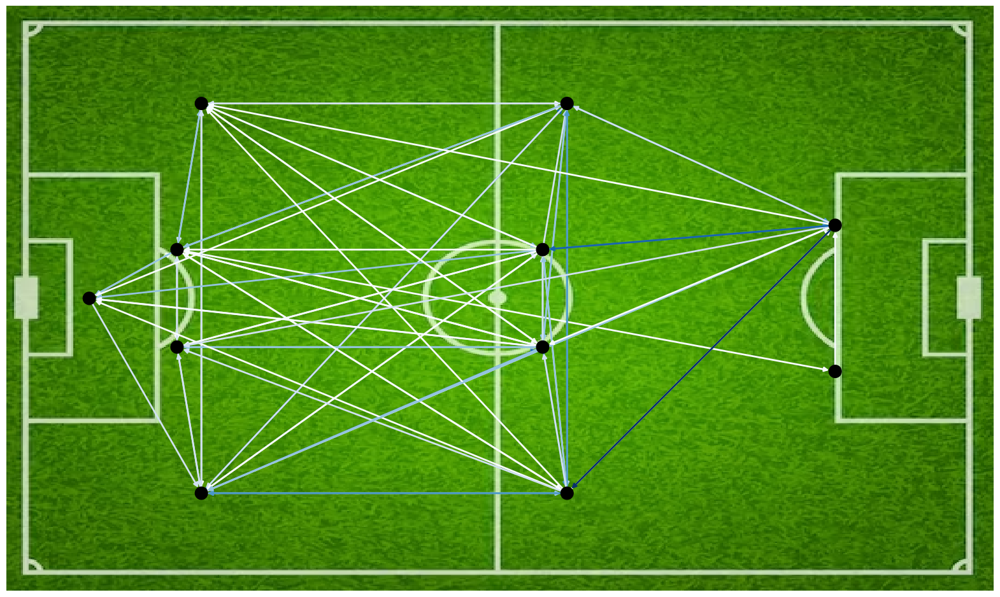

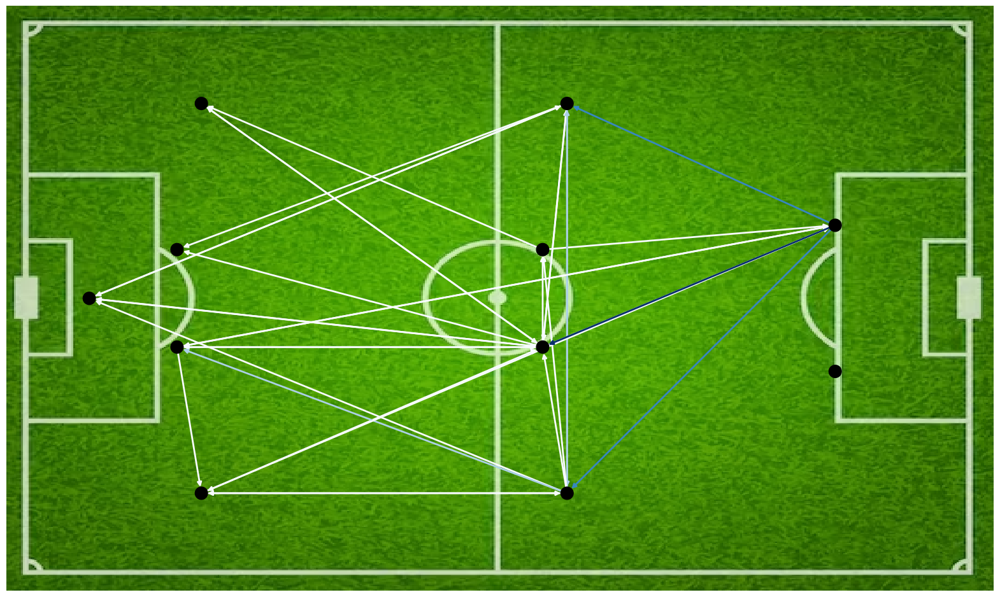

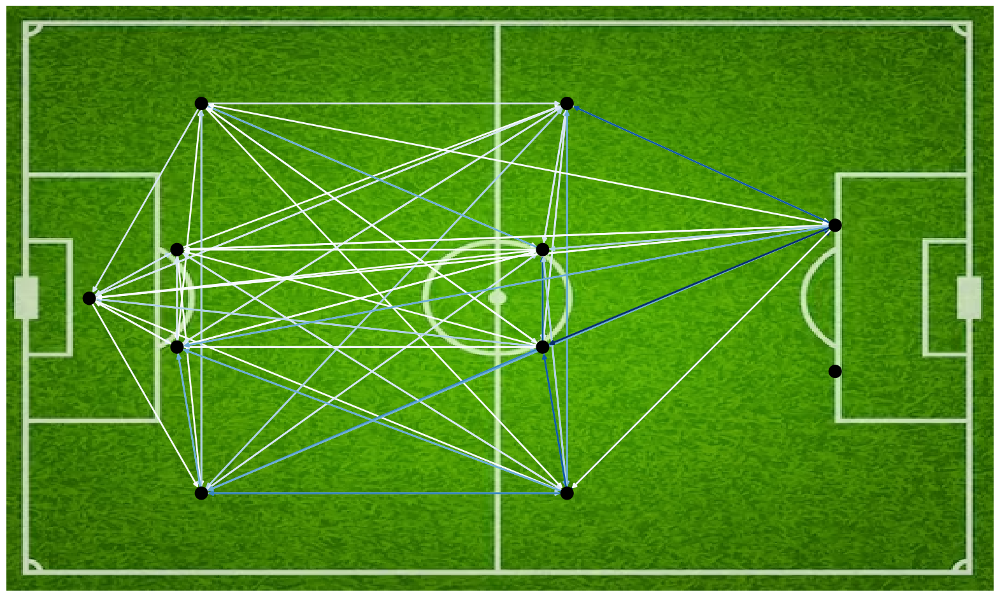

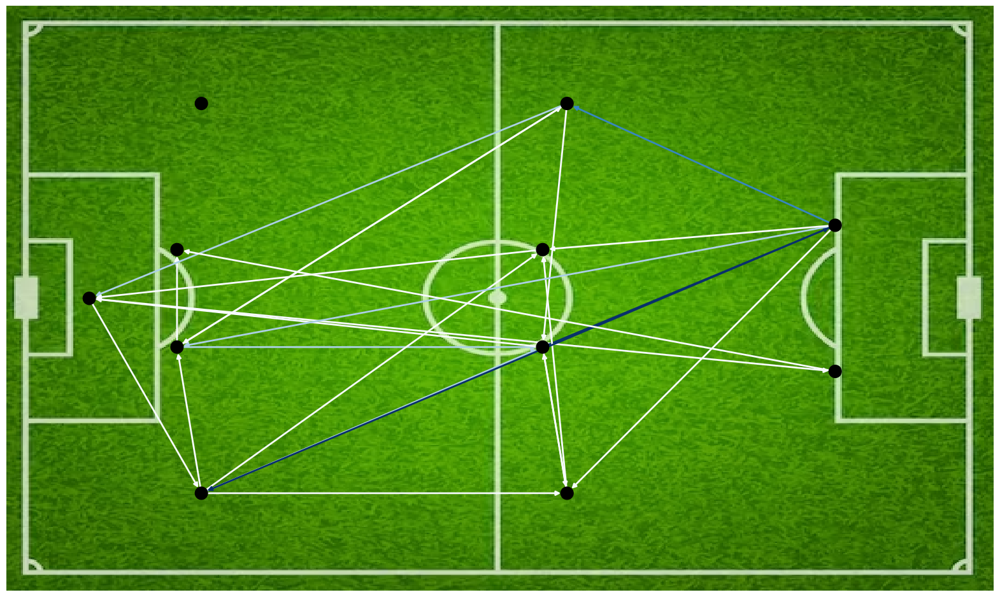

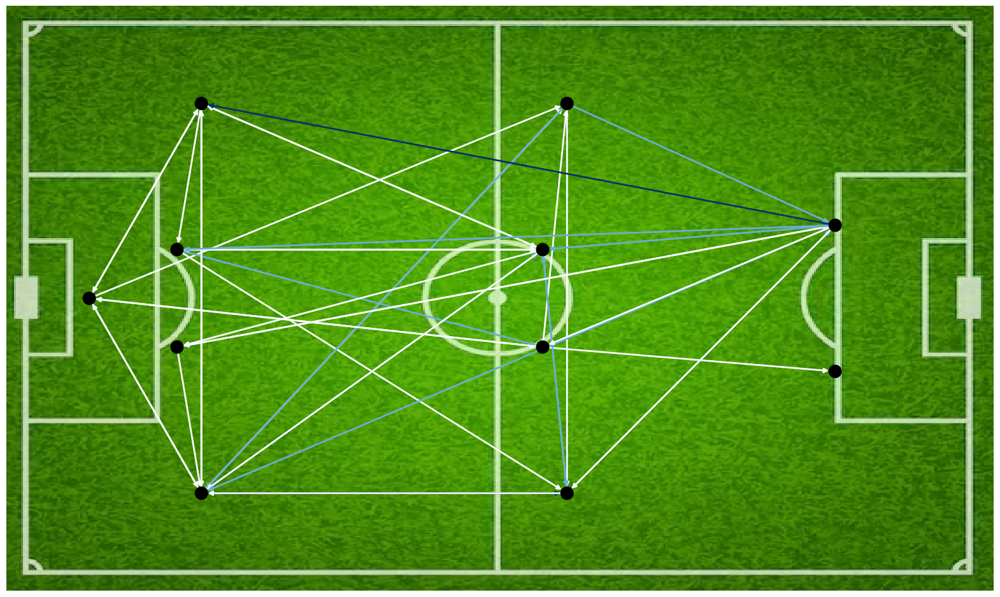

...

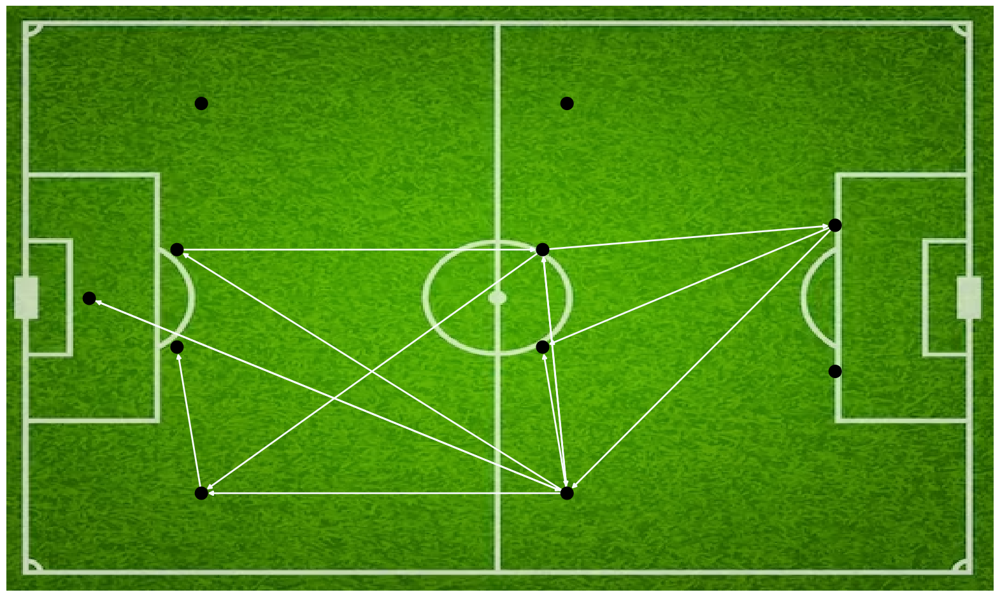

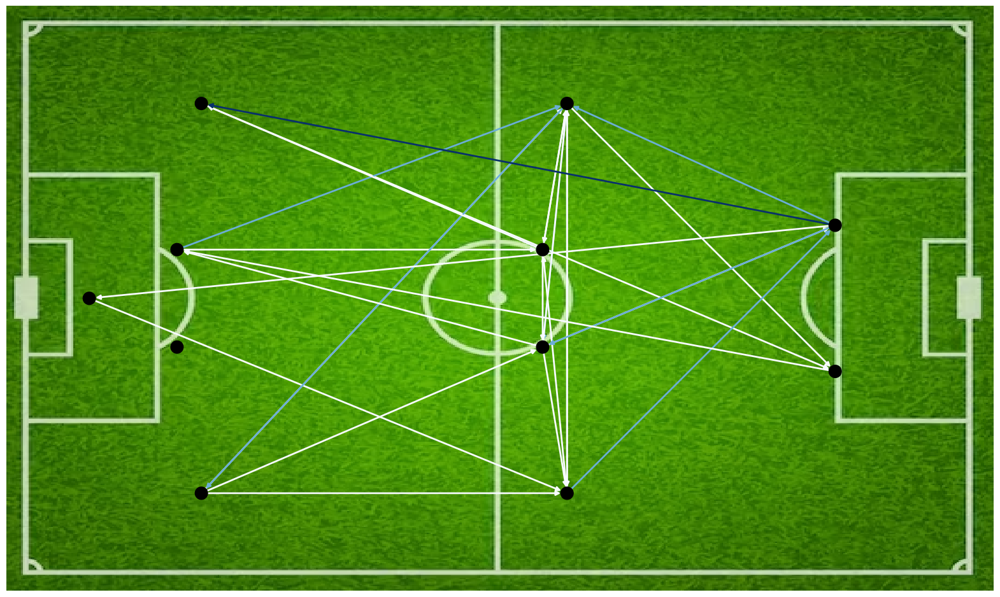

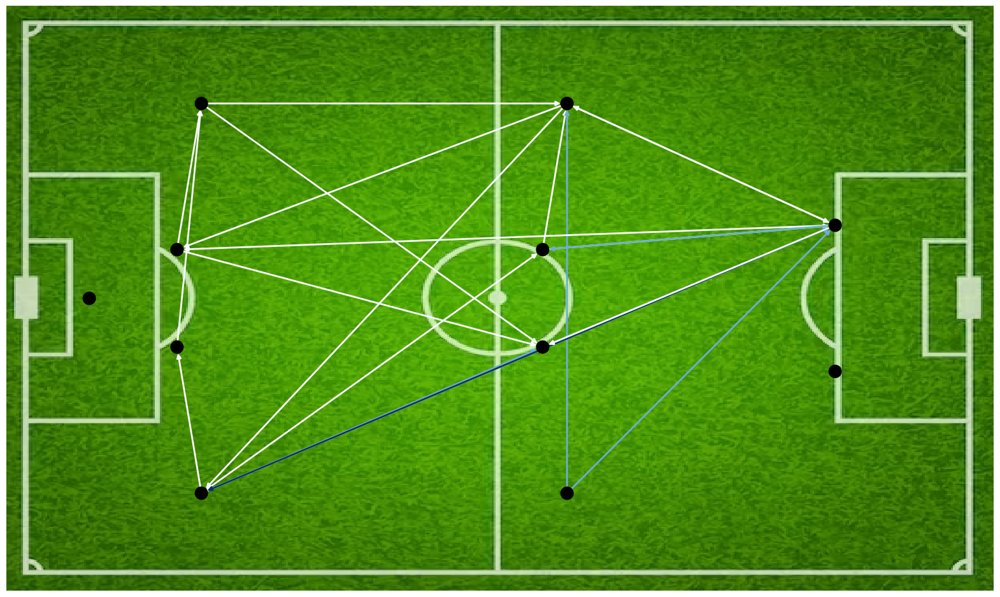

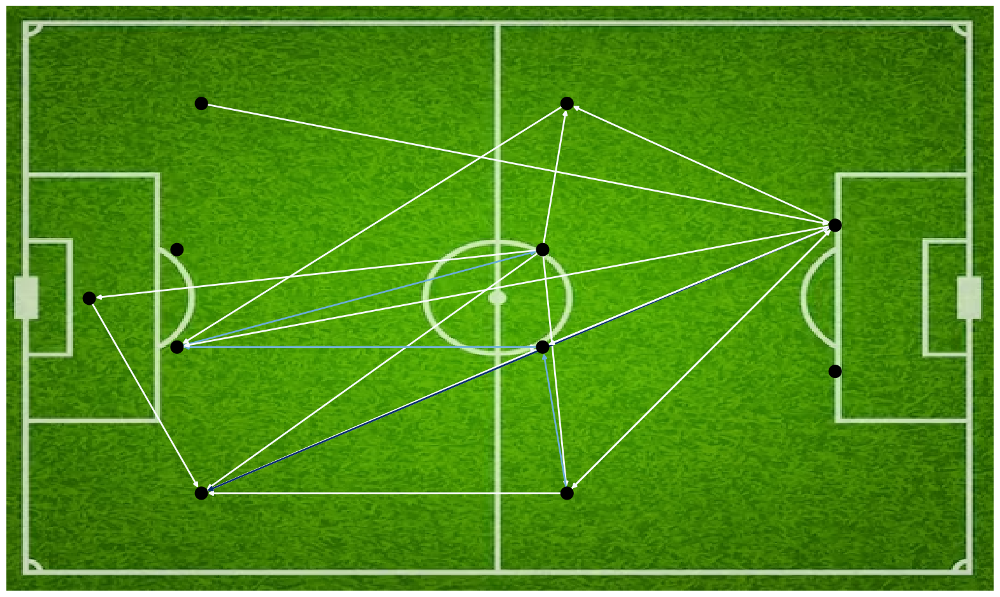

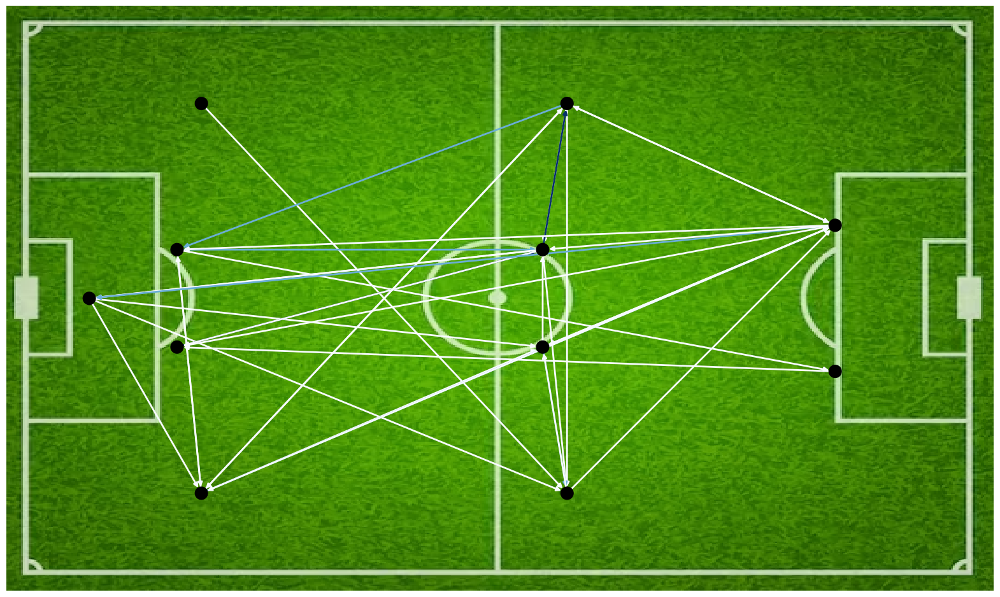

In [12]:
# Define coords for player positions
x = [34, 80, 70, 70, 80, 230, 220, 220, 230, 340, 340]
y = [120, 200, 140, 100, 40, 200, 140, 100, 40, 150, 90]

coords = {}
for i in range(11):
    coords[i] = zip([x[i], y[i]])

# Output player network for each team
for teamId in total_goals_matrices_england.keys():
    adjMat = total_goals_matrices_england[teamId]['total_player_matrix']

    G = nx.DiGraph.reverse(nx.from_numpy_array(np.matrix(adjMat), create_using=nx.DiGraph))
    coords = list(zip(x,y))
    
    fig = plt.figure(frameon=False, figsize=(20,40))
    
    plt.imshow(img, extent=extent, interpolation='nearest')
        
    pos = {}
    for i in range(11):
            pos[i] = coords[i]
    
    edgewidth = [ d['weight'] for (u,v,d) in G.edges(data=True)]
    color_map = ['black'] * 11   
    nx.draw(G,
            pos=pos,
            node_size=200,
            edge_color=edgewidth,
            node_color=color_map,
            edge_cmap=plt.cm.Blues,
            width=2)
    plt.savefig(f'../images/teamsPlayersGraphs/england/{teamId}.png')
    plt.show()


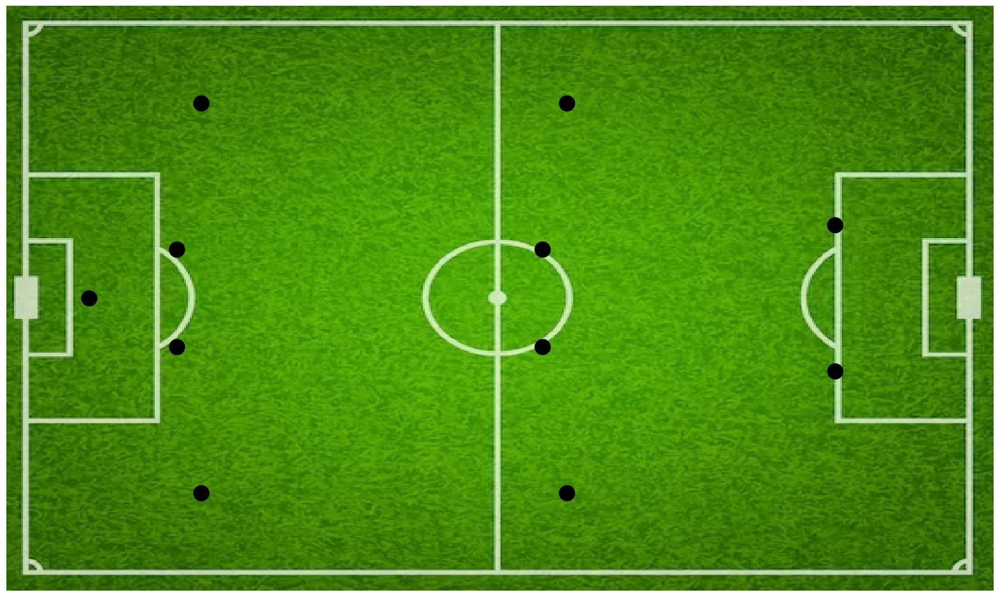

In [44]:
# Output empty graph for report
x = [34, 80, 70, 70, 80, 230, 220, 220, 230, 340, 340]
y = [120, 200, 140, 100, 40, 200, 140, 100, 40, 150, 90]

coords = {}
for i in range(11):
    coords[i] = zip([x[i], y[i]])

# adjMat = total_goals_matrices_england['1609']['total_player_matrix']

G = nx.DiGraph.reverse(nx.from_numpy_array(np.matrix(adjMat), create_using=nx.DiGraph))
coords = list(zip(x,y))

fig = plt.figure(frameon=False, figsize=(20,40))

plt.imshow(img, extent=extent, interpolation='nearest')
    
pos = {}
for i in range(11):
        pos[i] = coords[i]

# edgewidth = [ d['weight'] for (u,v,d) in G.edges(data=True)]
color_map = ['black'] * 11        
graph = nx.draw_networkx(G,pos, node_color=color_map)
nx.draw(G,
        pos=pos,
        node_size=200,
        node_color=color_map,
        edge_color=edgewidth,
        edge_cmap=plt.cm.Blues,
        width=2)

    # plt.show()


In [ ]:
# output network for testing

In [37]:
adjMat = np.zeros((11,11))

In [33]:
adjMat

array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]])